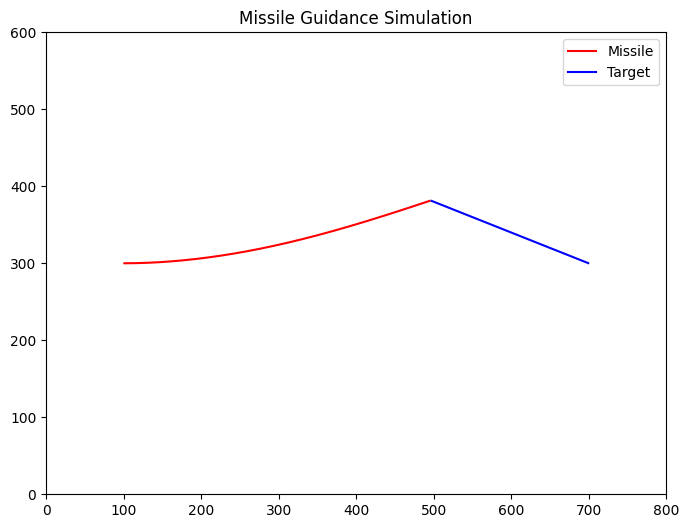

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Simulation parameters
SCREEN_WIDTH = 800
SCREEN_HEIGHT = 600
DT = 0.01  # Time step for simulation

class Target:
    def __init__(self, pos, velocity):
        self.pos = np.array(pos, dtype=float)
        self.velocity = np.array(velocity, dtype=float)
        self.history = []  # For trajectory

    def update(self, dt):
        self.pos += self.velocity * dt
        self.history.append(self.pos.copy())

class Missile:
    def __init__(self, pos, speed, target):
        self.pos = np.array(pos, dtype=float)
        self.velocity = np.array([speed, 0], dtype=float)  # Initial velocity towards positive x
        self.speed = speed
        self.target = target
        self.acceleration = 20.0  # Max lateral acceleration
        self.history = []  # For trajectory

    def update(self, dt):
        # Proportional Navigation Guidance (simple PN law)
        rel_pos = self.target.pos - self.pos
        rel_vel = self.target.velocity - self.velocity
        dist = np.linalg.norm(rel_pos)
        if dist == 0:
            return True

        # Line of sight (LOS) rate
        los = rel_pos / dist
        los_rate = np.dot(rel_vel, np.array([-los[1], los[0]])) / dist  # Perp component

        # Navigation constant N (typically 3-5)
        N = 4.0
        cmd_accel = N * self.speed * los_rate

        # Apply acceleration perpendicular to velocity
        vel_dir = self.velocity / self.speed
        perp_dir = np.array([-vel_dir[1], vel_dir[0]])
        accel_vec = cmd_accel * perp_dir
        accel_vec = np.clip(accel_vec, -self.acceleration, self.acceleration)  # Limit accel

        self.velocity += accel_vec * dt
        self.velocity = (self.velocity / np.linalg.norm(self.velocity)) * self.speed  # Maintain speed

        self.pos += self.velocity * dt
        self.history.append(self.pos.copy())

        # Check for intercept
        if dist < 5:  # Hit threshold
            return True
        return False

# Run simulation
target = Target([700, 300], [-50, 20])  # Position and velocity
missile = Missile([100, 300], 100, target)  # Position, speed, target

intercepted = False
max_steps = 10000  # Prevent infinite loop
step = 0

while not intercepted and step < max_steps:
    target.update(DT)
    intercepted = missile.update(DT)
    step += 1

    # Check bounds
    if not (0 < missile.pos[0] < SCREEN_WIDTH and 0 < missile.pos[1] < SCREEN_HEIGHT) or \
       not (0 < target.pos[0] < SCREEN_WIDTH and 0 < target.pos[1] < SCREEN_HEIGHT):
        break

# Create animation
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_xlim(0, SCREEN_WIDTH)
ax.set_ylim(0, SCREEN_HEIGHT)
ax.set_title("Missile Guidance Simulation")

missile_line, = ax.plot([], [], 'r-', label='Missile')
target_line, = ax.plot([], [], 'b-', label='Target')
ax.legend()

def init():
    missile_line.set_data([], [])
    target_line.set_data([], [])
    return missile_line, target_line

def animate(i):
    missile_line.set_data([p[0] for p in missile.history[:i+1]], [p[1] for p in missile.history[:i+1]])
    target_line.set_data([p[0] for p in target.history[:i+1]], [p[1] for p in target.history[:i+1]])
    return missile_line, target_line

anim = FuncAnimation(fig, animate, init_func=init, frames=len(missile.history), interval=20, blit=True)

# Display the animation
HTML(anim.to_jshtml())

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Simulation parameters
SCREEN_WIDTH = 800
SCREEN_HEIGHT = 600
DT = 0.01  # Time step for simulation

class Target:
    def __init__(self, pos, velocity, missiles):
        self.pos = np.array(pos, dtype=float)
        self.velocity = np.array(velocity, dtype=float)
        self.speed = np.linalg.norm(self.velocity)
        self.missiles = missiles  # List of missiles for evasion
        self.history = []  # For trajectory
        self.evasion_accel = 10.0  # Acceleration for evasion

    def update(self, dt):
        # Evasion logic: move away from average missile direction with random perturbation
        if self.missiles:
            rel_positions = [self.pos - m.pos for m in self.missiles if np.linalg.norm(self.pos - m.pos) > 0]
            if rel_positions:
                avg_rel = np.mean(rel_positions, axis=0)
                dist = np.linalg.norm(avg_rel)
                if dist > 0:
                    away_dir = avg_rel / dist
                else:
                    away_dir = np.array([1.0, 0.0])
            else:
                away_dir = np.array([1.0, 0.0])
        else:
            away_dir = np.array([1.0, 0.0])

        # Add random perturbation
        theta = np.arctan2(away_dir[1], away_dir[0])
        theta += np.random.uniform(-np.pi / 6, np.pi / 6)  # Random angle perturbation
        away_dir = np.array([np.cos(theta), np.sin(theta)])

        # Update velocity direction while maintaining speed
        self.velocity = self.speed * away_dir

        # Optional: add random speed variation
        self.speed += np.random.uniform(-5, 5)
        self.speed = np.clip(self.speed, 20, 80)  # Keep speed reasonable

        self.pos += self.velocity * dt
        self.history.append(self.pos.copy())

class Missile:
    def __init__(self, pos, speed, target):
        self.pos = np.array(pos, dtype=float)
        self.velocity = np.array([speed, 0], dtype=float)  # Initial velocity towards positive x
        self.speed = speed
        self.target = target
        self.acceleration = 30.0  # Max lateral acceleration (higher for better guidance)
        self.history = []  # For trajectory

    def update(self, dt):
        # Proportional Navigation Guidance (simple PN law)
        rel_pos = self.target.pos - self.pos
        rel_vel = self.target.velocity - self.velocity
        dist = np.linalg.norm(rel_pos)
        if dist == 0:
            return True

        # Line of sight (LOS) rate
        los = rel_pos / dist
        los_rate = np.dot(rel_vel, np.array([-los[1], los[0]])) / dist  # Perp component

        # Navigation constant N (typically 3-5)
        N = 4.0
        cmd_accel = N * self.speed * los_rate

        # Apply acceleration perpendicular to velocity
        vel_dir = self.velocity / self.speed
        perp_dir = np.array([-vel_dir[1], vel_dir[0]])
        accel_vec = cmd_accel * perp_dir
        accel_vec = np.clip(accel_vec, -self.acceleration, self.acceleration)  # Limit accel

        self.velocity += accel_vec * dt
        self.velocity = (self.velocity / np.linalg.norm(self.velocity)) * self.speed  # Maintain speed

        self.pos += self.velocity * dt
        self.history.append(self.pos.copy())

        # Check for intercept
        if dist < 5:  # Hit threshold
            return True
        return False

# Run simulation
missiles = [
    Missile([100, 250], 120, None),  # Will set target later
    Missile([100, 350], 120, None),
    Missile([100, 450], 120, None)
]
target = Target([700, 300], [-50, 20], missiles)
for m in missiles:
    m.target = target  # Set target for missiles

intercepted = False
max_steps = 10000  # Prevent infinite loop
step = 0

while not intercepted and step < max_steps:
    target.update(DT)
    hits = [m.update(DT) for m in missiles]
    intercepted = any(hits)
    step += 1

    # Check bounds
    out_of_bounds = False
    for m in missiles:
        if not (0 < m.pos[0] < SCREEN_WIDTH and 0 < m.pos[1] < SCREEN_HEIGHT):
            out_of_bounds = True
    if not (0 < target.pos[0] < SCREEN_WIDTH and 0 < target.pos[1] < SCREEN_HEIGHT):
        out_of_bounds = True
    if out_of_bounds:
        break

# Create animation
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_xlim(0, SCREEN_WIDTH)
ax.set_ylim(0, SCREEN_HEIGHT)
ax.set_title("Multi-Missile Guidance Simulation with Evasive Target")

missile_lines = [ax.plot([], [], 'r-', label=f'Missile {i+1}')[0] for i in range(len(missiles))]
target_line, = ax.plot([], [], 'b-', label='Target')
ax.legend()

def init():
    for ml in missile_lines:
        ml.set_data([], [])
    target_line.set_data([], [])
    return missile_lines + [target_line]

def animate(frame):
    for i, ml in enumerate(missile_lines):
        ml.set_data(
            [p[0] for p in missiles[i].history[:frame+1]],
            [p[1] for p in missiles[i].history[:frame+1]]
        )
    target_line.set_data(
        [p[0] for p in target.history[:frame+1]],
        [p[1] for p in target.history[:frame+1]]
    )
    return missile_lines + [target_line]

# Determine the number of frames based on the shortest history
min_frames = min(len(m.history) for m in missiles + [target])
anim = FuncAnimation(fig, animate, init_func=init, frames=min_frames, interval=20, blit=True)

# Display the animation
HTML(anim.to_jshtml())

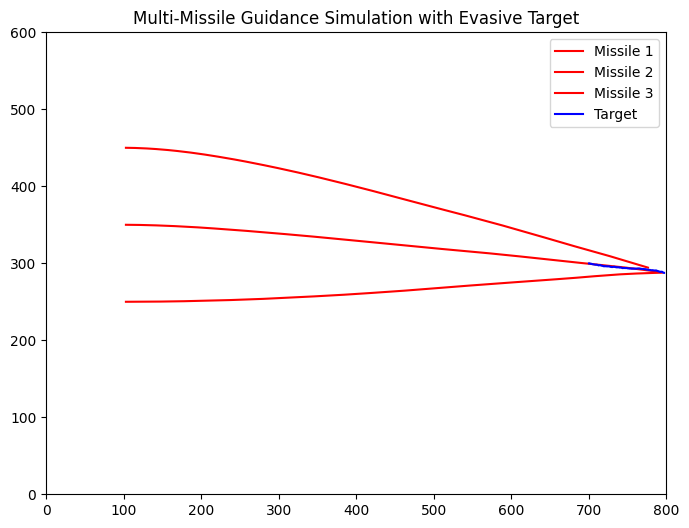

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Simulation parameters
SCREEN_WIDTH = 800
SCREEN_HEIGHT = 600
DT = 0.01  # Time step for simulation

class Target:
    def __init__(self, pos, velocity, missiles):
        self.pos = np.array(pos, dtype=float)
        self.velocity = np.array(velocity, dtype=float)
        self.speed = np.linalg.norm(self.velocity)
        self.missiles = missiles  # List of missiles for evasion
        self.history = []  # For trajectory
        self.evasion_accel = 10.0  # Acceleration for evasion

    def update(self, dt):
        # Evasion logic: move away from average missile direction with random perturbation
        if self.missiles:
            rel_positions = [self.pos - m.pos for m in self.missiles if np.linalg.norm(self.pos - m.pos) > 0]
            if rel_positions:
                avg_rel = np.mean(rel_positions, axis=0)
                dist = np.linalg.norm(avg_rel)
                if dist > 0:
                    away_dir = avg_rel / dist
                else:
                    away_dir = np.array([1.0, 0.0])
            else:
                away_dir = np.array([1.0, 0.0])
        else:
            away_dir = np.array([1.0, 0.0])

        # Add random perturbation
        theta = np.arctan2(away_dir[1], away_dir[0])
        theta += np.random.uniform(-np.pi / 6, np.pi / 6)  # Random angle perturbation
        away_dir = np.array([np.cos(theta), np.sin(theta)])

        # Update velocity direction while maintaining speed
        self.velocity = self.speed * away_dir

        # Optional: add random speed variation
        self.speed += np.random.uniform(-5, 5)
        self.speed = np.clip(self.speed, 20, 80)  # Keep speed reasonable

        self.pos += self.velocity * dt
        self.history.append(self.pos.copy())

class Missile:
    def __init__(self, pos, speed, target):
        self.pos = np.array(pos, dtype=float)
        self.velocity = np.array([speed, 0], dtype=float)  # Initial velocity towards positive x
        self.speed = speed
        self.target = target
        self.acceleration = 200.0  # Increased for better maneuverability
        self.history = []  # For trajectory

    def update(self, dt):
        # Proportional Navigation Guidance (simple PN law)
        rel_pos = self.target.pos - self.pos
        rel_vel = self.target.velocity - self.velocity
        dist = np.linalg.norm(rel_pos)
        if dist == 0:
            return True

        # Line of sight (LOS) rate
        los = rel_pos / dist
        los_rate = np.dot(rel_vel, np.array([-los[1], los[0]])) / dist  # Perp component

        # Navigation constant N (typically 3-5)
        N = 5.0
        cmd_accel = N * self.speed * los_rate

        # Apply acceleration perpendicular to velocity
        vel_dir = self.velocity / self.speed
        perp_dir = np.array([-vel_dir[1], vel_dir[0]])
        accel_vec = cmd_accel * perp_dir
        accel_vec = np.clip(accel_vec, -self.acceleration, self.acceleration)  # Limit accel

        self.velocity += accel_vec * dt
        self.velocity = (self.velocity / np.linalg.norm(self.velocity)) * self.speed  # Maintain speed

        self.pos += self.velocity * dt
        self.history.append(self.pos.copy())

        # Check for intercept
        if dist < 5:  # Hit threshold
            return True
        return False

# Set seed for reproducibility
np.random.seed(42)

# Run simulation
missiles = [
    Missile([100, 250], 300, None),  # Increased speed
    Missile([100, 350], 300, None),
    Missile([100, 450], 300, None)
]
target = Target([700, 300], [-50, 20], missiles)
for m in missiles:
    m.target = target  # Set target for missiles

intercepted = False
max_steps = 10000  # Prevent infinite loop
step = 0

while not intercepted and step < max_steps:
    target.update(DT)
    intercepted = any(m.update(DT) for m in missiles)  # Updated to any()
    step += 1

    # Check bounds
    out_of_bounds = False
    for m in missiles:
        if not (0 < m.pos[0] < SCREEN_WIDTH and 0 < m.pos[1] < SCREEN_HEIGHT):
            out_of_bounds = True
    if not (0 < target.pos[0] < SCREEN_WIDTH and 0 < target.pos[1] < SCREEN_HEIGHT):
        out_of_bounds = True
    if out_of_bounds:
        break

# Create animation
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_xlim(0, SCREEN_WIDTH)
ax.set_ylim(0, SCREEN_HEIGHT)
ax.set_title("Multi-Missile Guidance Simulation with Evasive Target")

missile_lines = [ax.plot([], [], 'r-', label=f'Missile {i+1}')[0] for i in range(len(missiles))]
target_line, = ax.plot([], [], 'b-', label='Target')
ax.legend()

def init():
    for ml in missile_lines:
        ml.set_data([], [])
    target_line.set_data([], [])
    return missile_lines + [target_line]

def animate(frame):
    for i, ml in enumerate(missile_lines):
        ml.set_data(
            [p[0] for p in missiles[i].history[:frame+1]],
            [p[1] for p in missiles[i].history[:frame+1]]
        )
    target_line.set_data(
        [p[0] for p in target.history[:frame+1]],
        [p[1] for p in target.history[:frame+1]]
    )
    return missile_lines + [target_line]

# Determine the number of frames based on the shortest history
min_frames = min(len(m.history) for m in missiles + [target])
anim = FuncAnimation(fig, animate, init_func=init, frames=min_frames, interval=20, blit=True)

# Display the animation
HTML(anim.to_jshtml())

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100    14  100    14    0     0     52      0 --:--:-- --:--:-- --:--:--    52
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100    14  100    14    0     0     51      0 --:--:-- --:--:-- --:--:--    51
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100    14  100    14    0     0     49      0 --:--:-- --:--:-- --:--:--    49
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100    14  100    14    0     0     53      0 --:--:-- --:--:-- --:--:--    53

Gravity Details

Acceleration of gravity at surface

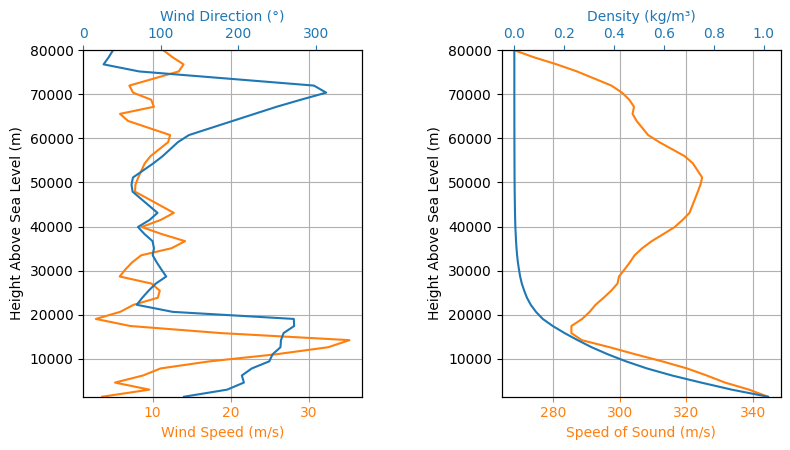

/usr/local/lib/python3.12/dist-packages/rocketpy/motors/motor.py:990: UserWarning: burn_time argument (0, 3.9) is out of thrust source time range. Using thrust_source boundary times instead: (0, 0.0) s.
If you want to change the burn out time of the curve please use the 'reshape_thrust_curve' argument.
  warnings.warn(


ZeroDivisionError: float division by zero

In [4]:
# Install RocketPy and dependencies
!pip install rocketpy
!pip install netCDF4
# Import necessary libraries
import datetime
from rocketpy import Environment, SolidMotor, Rocket, Flight
import os

# Create directory for data files
data_dir = "rocketpy_data"
os.makedirs(data_dir, exist_ok=True)

# Download sample data files from RocketPy GitHub (updated URLs)
!curl -L -o {data_dir}/Cesaroni_M1670.eng https://raw.githubusercontent.com/RocketPy-Team/RocketPy/main/data/motors/cesaroni/Cesaroni_M1670.eng
!curl -L -o {data_dir}/powerOffDragCurve.csv https://raw.githubusercontent.com/RocketPy-Team/RocketPy/main/data/rockets/calisto/powerOffDragCurve.csv
!curl -L -o {data_dir}/powerOnDragCurve.csv https://raw.githubusercontent.com/RocketPy-Team/RocketPy/main/data/rockets/calisto/powerOnDragCurve.csv
!curl -L -o {data_dir}/NACA0012-radians.txt https://raw.githubusercontent.com/RocketPy-Team/RocketPy/main/data/airfoils/NACA0012-radians.txt

# Define file paths
thrust_path = os.path.join(data_dir, "Cesaroni_M1670.eng")
power_off_drag_path = os.path.join(data_dir, "powerOffDragCurve.csv")
power_on_drag_path = os.path.join(data_dir, "powerOnDragCurve.csv")
airfoil_path = os.path.join(data_dir, "NACA0012-radians.txt")

# Step 1: Set up the Environment
env = Environment(latitude=32.990254, longitude=-106.974998, elevation=1400)

# Set date for tomorrow (adjust as needed)
tomorrow = datetime.date.today() + datetime.timedelta(days=1)
env.set_date((tomorrow.year, tomorrow.month, tomorrow.day, 12))  # Hour in UTC

# Use GFS forecast model
env.set_atmospheric_model(type="Forecast", file="GFS")

# Print environment info
env.info()

# Step 2: Define the Solid Motor
Pro75M1670 = SolidMotor(
    thrust_source=thrust_path,
    dry_mass=1.815,
    dry_inertia=(0.125, 0.125, 0.002),
    nozzle_radius=33 / 1000,
    grain_number=5,
    grain_density=1815,
    grain_outer_radius=33 / 1000,
    grain_initial_inner_radius=15 / 1000,
    grain_initial_height=120 / 1000,
    grain_separation=5 / 1000,
    grains_center_of_mass_position=0.397,
    center_of_dry_mass_position=0.317,
    nozzle_position=0,
    burn_time=3.9,
    throat_radius=11 / 1000,
    coordinate_system_orientation="nozzle_to_combustion_chamber",
)

# Print motor info
Pro75M1670.info()

# Step 3: Define the Rocket
calisto = Rocket(
    radius=127 / 2000,
    mass=14.426,  # Dry mass without motor
    inertia=(6.321, 6.321, 0.034),
    power_off_drag=power_off_drag_path,
    power_on_drag=power_on_drag_path,
    center_of_mass_without_motor=0,
    coordinate_system_orientation="tail_to_nose",
)

# Add motor to rocket
calisto.add_motor(Pro75M1670, position=-1.255)

# Add rail buttons
rail_buttons = calisto.set_rail_buttons(
    upper_button_position=0.0818,
    lower_button_position=-0.6182,
    angular_position=45,
)

# Add nose cone
nose_cone = calisto.add_nose(length=0.55829, kind="von karman", position=1.278)

# Add trapezoidal fins
fin_set = calisto.add_trapezoidal_fins(
    n=4,
    root_chord=0.120,
    tip_chord=0.060,
    span=0.110,
    position=-1.04956,
    cant_angle=0.5,
    airfoil=(airfoil_path, "radians"),
)

# Add tail
tail = calisto.add_tail(
    top_radius=0.0635, bottom_radius=0.0435, length=0.060, position=-1.194656
)

# Add parachutes
main = calisto.add_parachute(
    name="main",
    cd_s=10.0,
    trigger=800,  # Ejection at 800m altitude
    sampling_rate=105,
    lag=1.5,
    noise=(0, 8.3, 0.5),
)

drogue = calisto.add_parachute(
    name="drogue",
    cd_s=1.0,
    trigger="apogee",  # Ejection at apogee
    sampling_rate=105,
    lag=1.5,
    noise=(0, 8.3, 0.5),
)

# Plot static margin and draw rocket
calisto.plots.static_margin()
calisto.draw()

# Step 4: Run the Flight Simulation
test_flight = Flight(
    rocket=calisto, environment=env, rail_length=5.2, inclination=85, heading=0
)

# Step 5: Analyze and Plot Results
test_flight.all_info()  # Displays all plots and numerical summaries


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100    14  100    14    0     0     53      0 --:--:-- --:--:-- --:--:--    53
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100    14  100    14    0     0     61      0 --:--:-- --:--:-- --:--:--    61
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100    14  100    14    0     0     60      0 --:--:-- --:--:-- --:--:--    60
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100    14  100    14    0     0     58      0 --:--:-- --:--:-- --:--:--    58

Gravity Details

Acceleration of gravity at surface

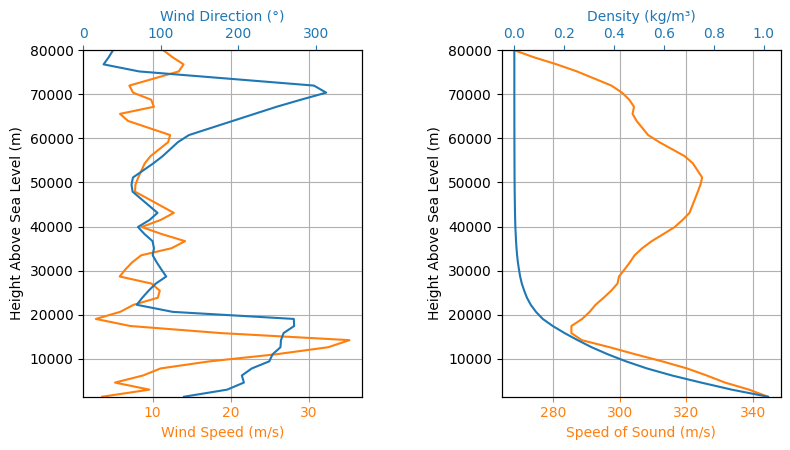

/usr/local/lib/python3.12/dist-packages/rocketpy/motors/motor.py:990: UserWarning: burn_time argument (0, 3.9) is out of thrust source time range. Using thrust_source boundary times instead: (0, 0.0) s.
If you want to change the burn out time of the curve please use the 'reshape_thrust_curve' argument.
  warnings.warn(


ZeroDivisionError: float division by zero

In [6]:
# Install RocketPy and dependencies
!pip install rocketpy

# Import necessary libraries
import datetime
from rocketpy import Environment, SolidMotor, Rocket, Flight
import os

# Create directory for data files
data_dir = "rocketpy_data"
os.makedirs(data_dir, exist_ok=True)

# Download sample data files from RocketPy GitHub (corrected fixture URLs)
!curl -L -o {data_dir}/Cesaroni_M1670.eng https://raw.githubusercontent.com/RocketPy-Team/RocketPy/main/tests/fixtures/motors/cesaroni_m1670_motor/Cesaroni_M1670.eng
!curl -L -o {data_dir}/powerOffDragCurve.csv https://raw.githubusercontent.com/RocketPy-Team/RocketPy/main/tests/fixtures/rockets/calisto/power_off_drag.csv
!curl -L -o {data_dir}/powerOnDragCurve.csv https://raw.githubusercontent.com/RocketPy-Team/RocketPy/main/tests/fixtures/rockets/calisto/power_on_drag.csv
!curl -L -o {data_dir}/NACA0012-radians.txt https://raw.githubusercontent.com/RocketPy-Team/RocketPy/main/tests/fixtures/aerodynamic_surfaces/NACA0012-radians.txt

# Define file paths
thrust_path = os.path.join(data_dir, "Cesaroni_M1670.eng")
power_off_drag_path = os.path.join(data_dir, "powerOffDragCurve.csv")
power_on_drag_path = os.path.join(data_dir, "powerOnDragCurve.csv")
airfoil_path = os.path.join(data_dir, "NACA0012-radians.txt")

# Step 1: Set up the Environment
env = Environment(latitude=32.990254, longitude=-106.974998, elevation=1400)

# Set date for tomorrow (adjust as needed)
tomorrow = datetime.date.today() + datetime.timedelta(days=1)
env.set_date((tomorrow.year, tomorrow.month, tomorrow.day, 12))  # Hour in UTC

# Use GFS forecast model
env.set_atmospheric_model(type="Forecast", file="GFS")

# Print environment info
env.info()

# Step 2: Define the Solid Motor
Pro75M1670 = SolidMotor(
    thrust_source=thrust_path,
    dry_mass=1.815,
    dry_inertia=(0.125, 0.125, 0.002),
    nozzle_radius=33 / 1000,
    grain_number=5,
    grain_density=1815,
    grain_outer_radius=33 / 1000,
    grain_initial_inner_radius=15 / 1000,
    grain_initial_height=120 / 1000,
    grain_separation=5 / 1000,
    grains_center_of_mass_position=0.397,
    center_of_dry_mass_position=0.317,
    nozzle_position=0,
    burn_time=3.9,
    throat_radius=11 / 1000,
    coordinate_system_orientation="nozzle_to_combustion_chamber",
)

# Print motor info
Pro75M1670.info()

# Step 3: Define the Rocket
calisto = Rocket(
    radius=127 / 2000,
    mass=14.426,  # Dry mass without motor
    inertia=(6.321, 6.321, 0.034),
    power_off_drag=power_off_drag_path,
    power_on_drag=power_on_drag_path,
    center_of_mass_without_motor=0,
    coordinate_system_orientation="tail_to_nose",
)

# Add motor to rocket
calisto.add_motor(Pro75M1670, position=-1.255)

# Add rail buttons
rail_buttons = calisto.set_rail_buttons(
    upper_button_position=0.0818,
    lower_button_position=-0.6182,
    angular_position=45,
)

# Add nose cone
nose_cone = calisto.add_nose(length=0.55829, kind="von karman", position=1.278)

# Add trapezoidal fins
fin_set = calisto.add_trapezoidal_fins(
    n=4,
    root_chord=0.120,
    tip_chord=0.060,
    span=0.110,
    position=-1.04956,
    cant_angle=0.5,
    airfoil=(airfoil_path, "radians"),
)

# Add tail
tail = calisto.add_tail(
    top_radius=0.0635, bottom_radius=0.0435, length=0.060, position=-1.194656
)

# Add parachutes
main = calisto.add_parachute(
    name="main",
    cd_s=10.0,
    trigger=800,  # Ejection at 800m altitude
    sampling_rate=105,
    lag=1.5,
    noise=(0, 8.3, 0.5),
)

drogue = calisto.add_parachute(
    name="drogue",
    cd_s=1.0,
    trigger="apogee",  # Ejection at apogee
    sampling_rate=105,
    lag=1.5,
    noise=(0, 8.3, 0.5),
)

# Plot static margin and draw rocket
calisto.plots.static_margin()
calisto.draw()

# Step 4: Run the Flight Simulation
test_flight = Flight(
    rocket=calisto, environment=env, rail_length=5.2, inclination=85, heading=0
)

# Step 5: Analyze and Plot Results
test_flight.all_info()  # Displays all plots and numerical summaries
